### imports

In [1]:
import pandas as pd
import numpy as np
import warnings
#warnings.filterwarnings('ignore')
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import recall_score

In [2]:
df = pd.read_csv('data/kickstarter_projects.csv')

In [3]:
df_original = df.copy

### first look / quick EDA

In [4]:
df.head()

,ID,Name,Category,Subcategory,Country,Launched,Deadline,Goal,Pledged,Backers,State
0,1860890148,Grace Jones Does Not Give A F$#% T-Shirt (limi...,Fashion,Fashion,United States,2009-04-21 21:02:48,2009-05-31,1000,625,30,Failed
1,709707365,CRYSTAL ANTLERS UNTITLED MOVIE,Film & Video,Shorts,United States,2009-04-23 00:07:53,2009-07-20,80000,22,3,Failed
2,1703704063,drawing for dollars,Art,Illustration,United States,2009-04-24 21:52:03,2009-05-03,20,35,3,Successful
3,727286,Offline Wikipedia iPhone app,Technology,Software,United States,2009-04-25 17:36:21,2009-07-14,99,145,25,Successful
4,1622952265,Pantshirts,Fashion,Fashion,United States,2009-04-27 14:10:39,2009-05-26,1900,387,10,Failed


In [5]:
df.tail()

,ID,Name,Category,Subcategory,Country,Launched,Deadline,Goal,Pledged,Backers,State
374848,1486845240,Americas Got Talent - Serious MAK,Music,Hip-Hop,United States,2018-01-02 14:13:09,2018-01-16,500,0,0,Live
374849,974738310,EVO Planner: The World's First Personalized Fl...,Design,Product Design,United States,2018-01-02 14:15:38,2018-02-09,15000,269,8,Live
374850,2106246194,"Help save La Gattara, Arizona's first Cat Cafe!",Food,Food,United States,2018-01-02 14:17:46,2018-01-16,10000,165,3,Live
374851,1830173355,Digital Dagger Coin,Art,Art,United States,2018-01-02 14:38:17,2018-02-01,650,7,1,Live
374852,1339173863,Spirits of the Forest,Games,Tabletop Games,Spain,2018-01-02 15:02:31,2018-01-26,24274,4483,82,Live


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 374853 entries, 0 to 374852
Data columns (total 11 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   ID           374853 non-null  int64 
 1   Name         374853 non-null  object
 2   Category     374853 non-null  object
 3   Subcategory  374853 non-null  object
 4   Country      374853 non-null  object
 5   Launched     374853 non-null  object
 6   Deadline     374853 non-null  object
 7   Goal         374853 non-null  int64 
 8   Pledged      374853 non-null  int64 
 9   Backers      374853 non-null  int64 
 10  State        374853 non-null  object
dtypes: int64(4), object(7)
memory usage: 31.5+ MB


In [7]:
df.State.value_counts()


State
Failed        197611
Successful    133851
Canceled       38751
Live            2798
Suspended       1842
Name: count, dtype: int64

In [8]:
df[df.State.isin(["Failed","Successful"])]

,ID,Name,Category,Subcategory,Country,Launched,Deadline,Goal,Pledged,Backers,State
0,1860890148,Grace Jones Does Not Give A F$#% T-Shirt (limi...,Fashion,Fashion,United States,2009-04-21 21:02:48,2009-05-31,1000,625,30,Failed
1,709707365,CRYSTAL ANTLERS UNTITLED MOVIE,Film & Video,Shorts,United States,2009-04-23 00:07:53,2009-07-20,80000,22,3,Failed
2,1703704063,drawing for dollars,Art,Illustration,United States,2009-04-24 21:52:03,2009-05-03,20,35,3,Successful
3,727286,Offline Wikipedia iPhone app,Technology,Software,United States,2009-04-25 17:36:21,2009-07-14,99,145,25,Successful
4,1622952265,Pantshirts,Fashion,Fashion,United States,2009-04-27 14:10:39,2009-05-26,1900,387,10,Failed
...,...,...,...,...,...,...,...,...,...,...,...
374310,749399445,Propeller Spring 2.0,Games,Games,Austria,2017-12-23 10:14:21,2017-12-26,36,270,36,Successful
374400,1223058036,The Cowboy and The Spaceman: Android Collective+,Games,Tabletop Games,United Kingdom,2017-12-26 13:00:24,2017-12-31,271,545,25,Successful
374458,1411606124,The CHAMPS Are Here!,Fashion,Apparel,United States,2017-12-27 03:52:38,2017-12-31,200,202,6,Successful
374530,156799983,Kill Them All!,Games,Tabletop Games,United States,2017-12-28 01:48:58,2017-12-30,250,265,7,Successful


### first pre-processing / feature engineering

#### Datetime

In [9]:
df["Launched"] = pd.to_datetime(df["Launched"])
df["Deadline"] = pd.to_datetime(df["Deadline"])

In [10]:
df["lon_launched"] = df["Launched"].dt.date
df["time_launched"] = df["Launched"].dt.time
df["day_launched"] = df["Launched"].dt.weekday
df["day_launched_name"] = df["Launched"].dt.day_name()
df["hour"] = df["Launched"].dt.hour 

#### Feature: time of the day

In [11]:
# Transform hour into sine and cosine components
# idea: we want to capture the idea that hour = 23 is close to hour = 1 (next day): both are "around midnight"
# this would not be the case if we treated hours as a standard numerical (or categorical) variable
df["hour_sin"] = np.sin(2 * np.pi * df["hour"] / 24)
df["hour_cos"] = np.cos(2 * np.pi * df["hour"] / 24)

#### Feature: day of the week

In [12]:
df["weekday"] = df["day_launched"].astype("category")

In [13]:
df["day_launched_name"]

0          Tuesday
1         Thursday
2           Friday
3         Saturday
4           Monday
            ...   
374848     Tuesday
374849     Tuesday
374850     Tuesday
374851     Tuesday
374852     Tuesday
Name: day_launched_name, Length: 374853, dtype: object

In [14]:
weekday_dummies = pd.get_dummies(df["day_launched_name"], drop_first=True)
weekday_dummies

,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
0,False,False,False,False,True,False
1,False,False,False,True,False,False
2,False,False,False,False,False,False
3,False,True,False,False,False,False
4,True,False,False,False,False,False
...,...,...,...,...,...,...
374848,False,False,False,False,True,False
374849,False,False,False,False,True,False
374850,False,False,False,False,True,False
374851,False,False,False,False,True,False


In [15]:
weekday_dummies.columns

Index(['Monday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday', 'Wednesday'], dtype='object')

In [16]:
df = pd.concat([df, weekday_dummies], axis = 1)
df.head()

,ID,Name,Category,Subcategory,Country,Launched,Deadline,Goal,Pledged,Backers,...,hour,hour_sin,hour_cos,weekday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
0,1860890148,Grace Jones Does Not Give A F$#% T-Shirt (limi...,Fashion,Fashion,United States,2009-04-21 21:02:48,2009-05-31,1000,625,30,...,21,-0.707107,0.707107,1,False,False,False,False,True,False
1,709707365,CRYSTAL ANTLERS UNTITLED MOVIE,Film & Video,Shorts,United States,2009-04-23 00:07:53,2009-07-20,80000,22,3,...,0,0.000000,1.000000,3,False,False,False,True,False,False
2,1703704063,drawing for dollars,Art,Illustration,United States,2009-04-24 21:52:03,2009-05-03,20,35,3,...,21,-0.707107,0.707107,4,False,False,False,False,False,False
3,727286,Offline Wikipedia iPhone app,Technology,Software,United States,2009-04-25 17:36:21,2009-07-14,99,145,25,...,17,-0.965926,-0.258819,5,False,True,False,False,False,False
4,1622952265,Pantshirts,Fashion,Fashion,United States,2009-04-27 14:10:39,2009-05-26,1900,387,10,...,14,-0.500000,-0.866025,0,True,False,False,False,False,False


#### Feature: duration (number of days)

In [17]:
df["duration"] = (df["Deadline"] - df["Launched"]).dt.days

### Data cleaning

#### clean by state

In [18]:
df.State.value_counts().sum

<bound method NDFrame._add_numeric_operations.<locals>.sum of State
Failed        197611
Successful    133851
Canceled       38751
Live            2798
Suspended       1842
Name: count, dtype: int64>

We decide to drop projects that are still live (outcome unclear), suspended or canceled (reasons unclear, hypothetical outcome in case of continuation unclear).

In [19]:
df = df[df.State.isin(["Failed","Successful"])]
df.replace({"Failed":0, "Successful":1}, inplace=True)     

#### clean by duration

Note: Kickstarter reduced the upper duration limit from 90 to 60 days at some point _during_ the data collection phase (~2011). We throw out projects with a duration >60 days because this parameter choice became unavailable to projects after the change by the platform

In [20]:
df.query("duration >60").shape

(4136, 26)

In [21]:
df["duration"].unique()

array([39, 87,  8, 79, 28, 17, 29, 16, 48, 61, 65, 46, 36, 19, 35, 75, 30,
       34, 60, 27, 31, 25, 22, 55, 23, 52, 49, 80, 62,  9, 89, 72, 88, 59,
       58, 84, 32, 74, 41, 71, 51, 69, 73, 15, 21, 40, 43, 42, 57, 38, 37,
       86,  3, 20, 13, 10, 24, 66, 85, 64, 78, 54, 63, 47,  5, 83, 45, 50,
       44, 76,  7,  2,  4, 70,  6, 68, 67, 33, 56, 53, 82, 26, 77, 81, 12,
       18, 14,  1,  0, 11, 90, 91])

In [22]:
df = df.query("duration <= 60 ")
# we lose about 1% of the data

In [23]:
df.Launched.dt.year.value_counts()

Launched
2015    65266
2014    59303
2016    49092
2017    43419
2013    41084
2012    38478
2011    22465
2010     7597
2009      622
Name: count, dtype: int64

## More pre-processing / feature engineering

### Feature: goal - log scaling

Idea: account for the distribution of goal levels by applying logarithm.
To do this, we need to remove projects with a goal = 0 (also, they are not informative and there are just 3 of them)

apply log to "goal" target, turning it into a normally distributed variable
then cut off outliers (above & maybe also below)
this should cause us not to need scaling any more

In [24]:
df = df.query("Goal > 0")

In [25]:
df["goal_log"] = np.log(df['Goal'])

### Feature: goal - outlier identification

Here, we only identify the outliers. _Removal_ of the outliers comes _after_ the train-test-split.

Wikipedia on outliers:
> The interquartile range is often used to find outliers in data. Outliers here are defined as observations that fall below Q1 − 1.5 IQR or above Q3 + 1.5 IQR.

In [26]:
df.Category.value_counts()

Category
Film & Video    55086
Music           44782
Publishing      35086
Games           28423
Technology      26971
Art             25330
Design          25283
Food            21965
Fashion         19708
Theater         10008
Comics           9751
Photography      9521
Crafts           7799
Journalism       4085
Dance            3525
Name: count, dtype: int64

In [27]:
df.query("Category == 'Technology'").Subcategory.unique()

array(['Software', 'Technology', 'Hardware', 'Space Exploration',
       'Fabrication Tools', 'Apps', 'DIY Electronics', 'Robots', 'Sound',
       'Camera Equipment', 'Flight', 'Makerspaces', 'Gadgets',
       '3D Printing', 'Web', 'Wearables'], dtype=object)

In [28]:
categories = df.Category.unique()
#categories = df.query("Category == 'Technology'").Subcategory.unique()

In [29]:
outliers = {}
outliers_log_above = {}
outliers_log_below = {}
for category in categories:
    df_temp = df.query("Category == @category")
    outliers[category] = df_temp.Goal.quantile(.75) + 1.5 * (df_temp.Goal.quantile(.75) - df_temp.Goal.quantile(.25))
    outliers_log_above[category] = df_temp.goal_log.quantile(.75) + 1.5 * (df_temp.goal_log.quantile(.75) - df_temp.goal_log.quantile(.25))
    outliers_log_below[category] = df_temp.goal_log.quantile(.25) - 1.5 * (df_temp.goal_log.quantile(.75) - df_temp.goal_log.quantile(.25))
    #print(f"cutoff for {category}: {outliers[category]}")

### A closer look / more EDA

how to success rates differ across (sub)categories?

In [30]:
df.groupby("Category").State.mean().sort_values()

Category
Technology      0.237885
Journalism      0.241860
Crafts          0.270419
Food            0.275484
Fashion         0.283134
Photography     0.340090
Publishing      0.347689
Design          0.416248
Film & Video    0.420434
Games           0.439187
Art             0.448796
Music           0.527511
Comics          0.593990
Theater         0.641687
Dance           0.655603
Name: State, dtype: float64

In [31]:
df.groupby("Subcategory").State.mean().sort_values()

Subcategory
Apps            0.071496
Web             0.102808
Mobile Games    0.106029
Video           0.132468
Food Trucks     0.137865
                  ...   
Indie Rock      0.685501
Dance           0.698157
Anthologies     0.706920
Residencies     0.735294
Chiptune        0.818182
Name: State, Length: 159, dtype: float64

In [32]:
df[['State', 'Goal', 'duration']].corr()

,State,Goal,duration
State,1.000000,-0.023722,-0.126241
Goal,-0.023722,1.000000,0.024495
duration,-0.126241,0.024495,1.000000


#### Plotting

<Axes: xlabel='count', ylabel='Country'>

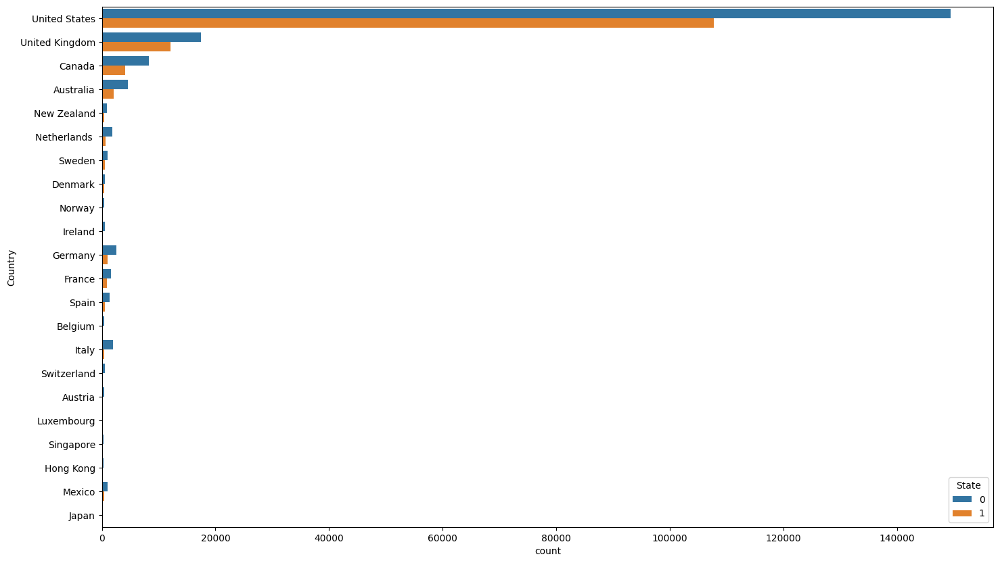

In [33]:
# by country
plt.figure(figsize=(17,10))
sns.countplot(y= df.Country , hue=df.State)

<Axes: xlabel='duration', ylabel='Count'>

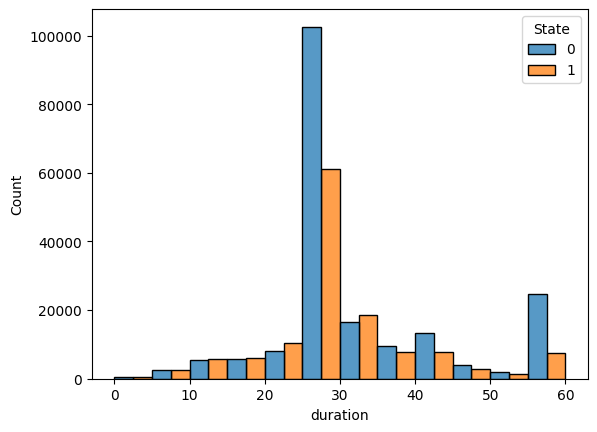

In [34]:
# by duration
sns.histplot(data = df, x="duration", hue="State", multiple="dodge", bins = 12)


<Axes: xlabel='Category', ylabel='count'>

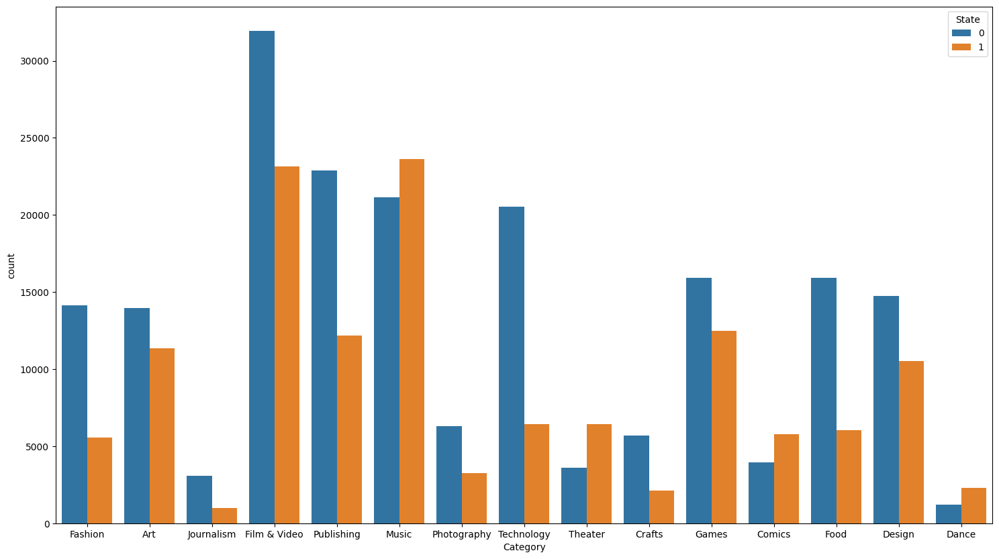

In [35]:
# by category
plt.figure(figsize=(18,10))
sns.countplot(x = df.Category , hue=df.State)

<Axes: xlabel='day_launched', ylabel='Count'>

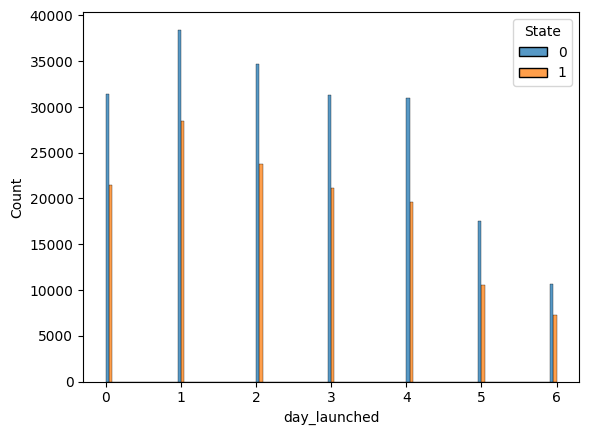

In [36]:
sns.histplot(data=df, x="day_launched", hue="State", multiple="dodge")

<Axes: title={'center': 'success rates per category'}, ylabel='Category'>

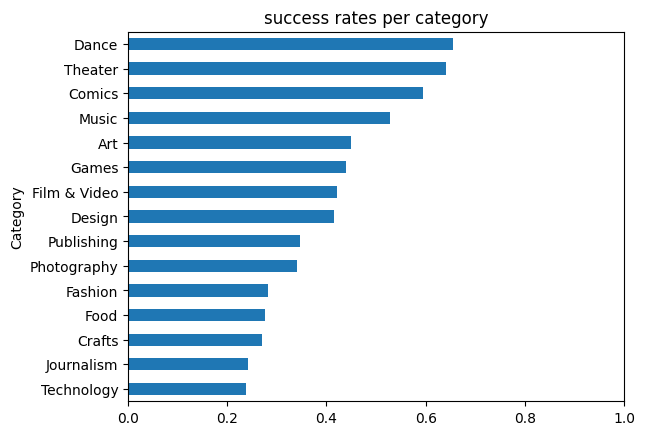

In [37]:
df.groupby("Category").State.mean().sort_values().plot(kind = "barh", xlim=[0,1], title="success rates per category")

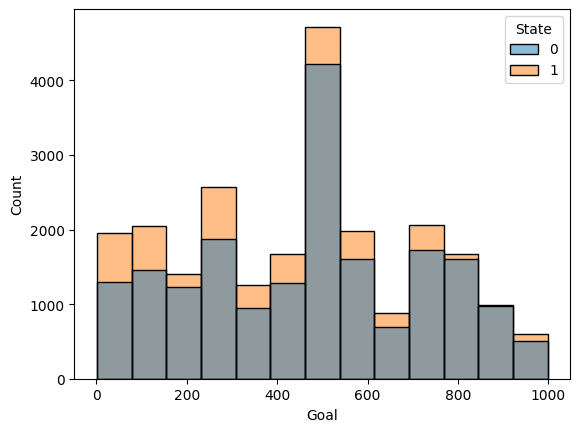

In [38]:
# by goal, with an upper limit
sns.histplot(data = df[df["Goal"] < 1000], x="Goal" , hue="State", bins=13);

<Axes: xlabel='Goal'>

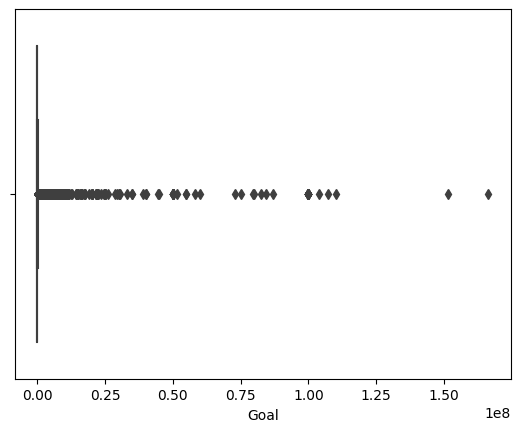

In [39]:
sns.boxplot(data = df, x = "Goal")

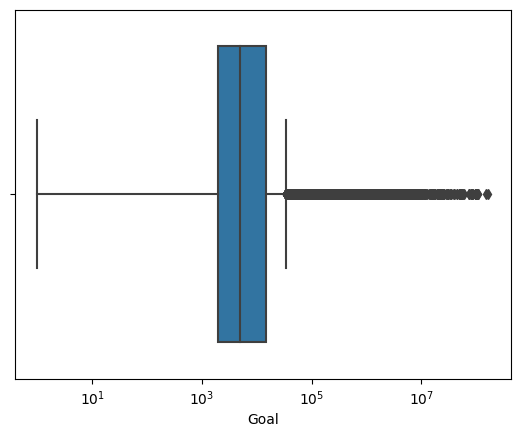

In [40]:
sns.boxplot(data = df, x = "Goal")
plt.xscale('log')

#### distribution of goals, original and log-scaled

<Axes: xlabel='Goal', ylabel='Count'>

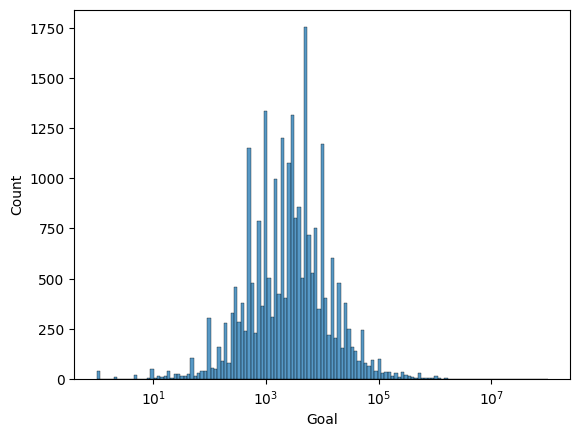

In [41]:
# log version of goal distribution for a given category 
sns.histplot(data = df.query("Category == 'Art'"), x = "Goal", log_scale = True)

<Axes: xlabel='goal_log', ylabel='Count'>

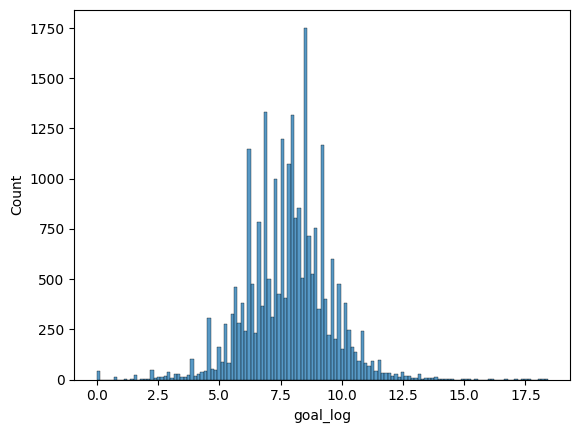

In [42]:
sns.histplot(data = df.query("Category == 'Art'"), x = "goal_log")

<Axes: ylabel='Frequency'>

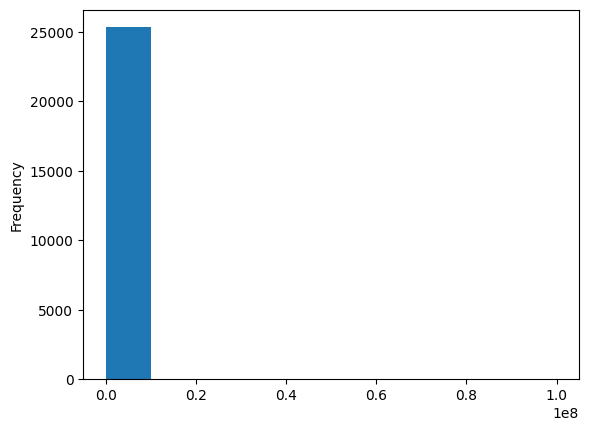

In [43]:
# non-log version of goal distribution
df.query("Category == 'Art'").Goal.plot(kind="hist")

#### EDA: outlier plotting

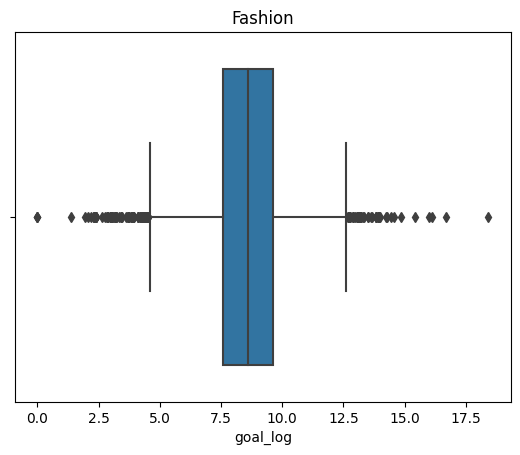

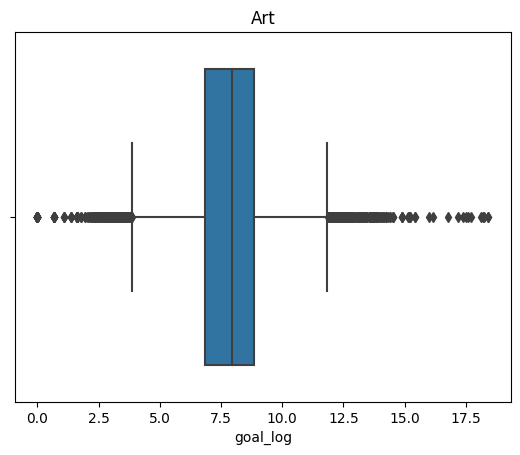

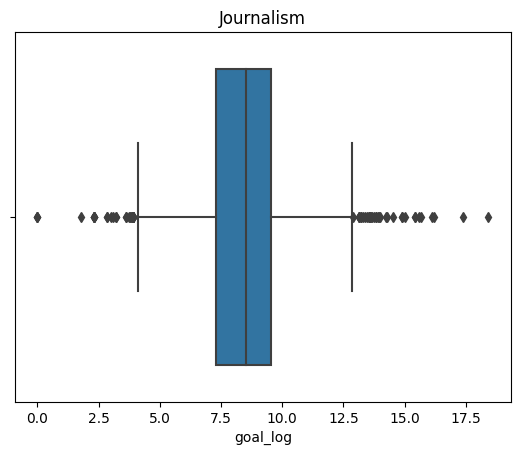

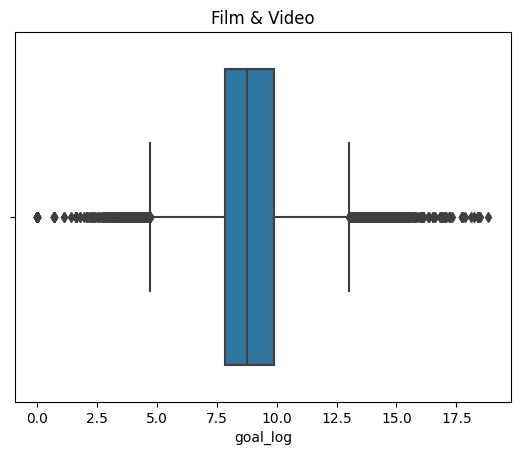

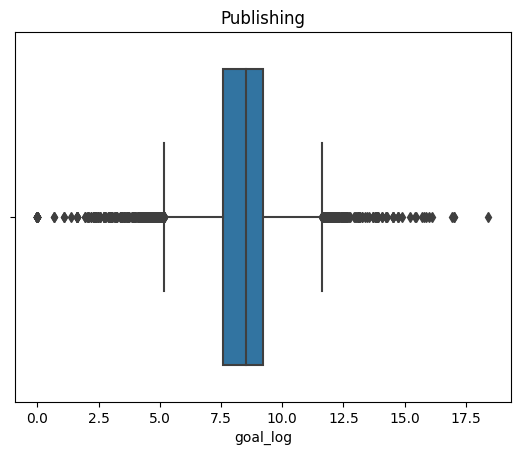

...

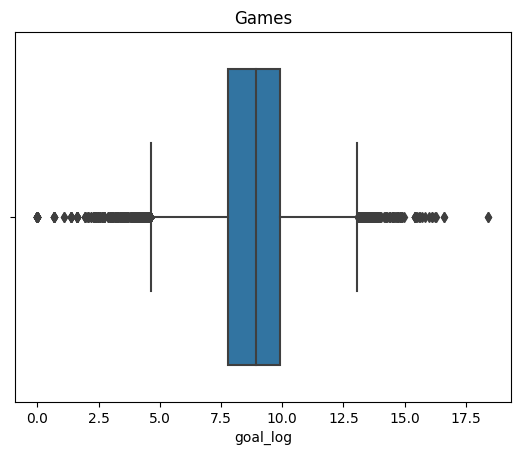

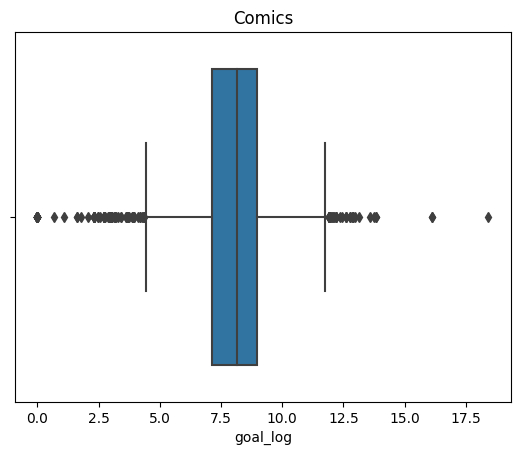

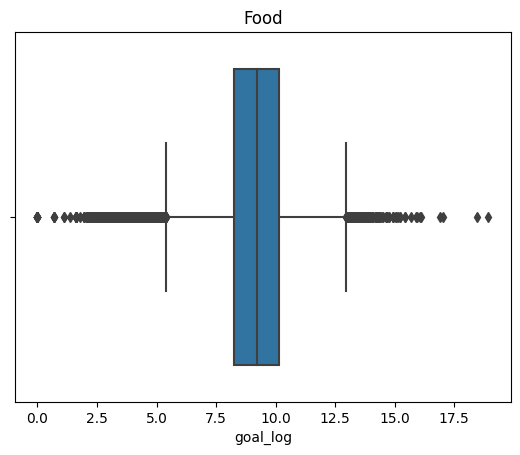

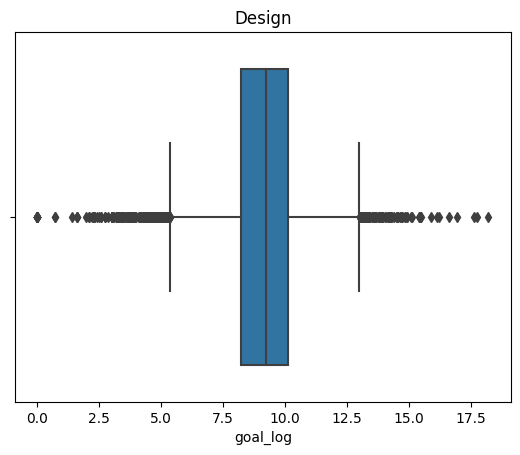

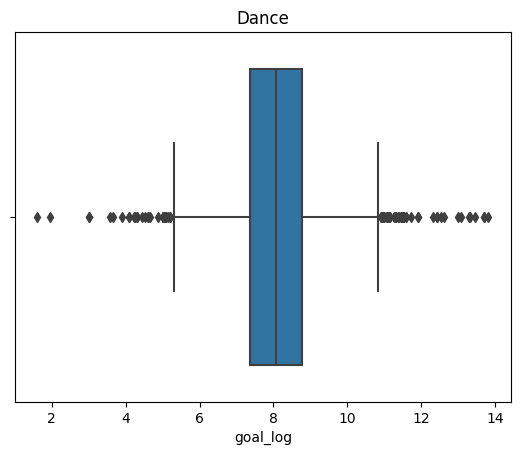

In [44]:
for category in categories:
    sns.boxplot(data = df.query('Category == @category'), x = 'goal_log')
    plt.title(category)
    plt.show()

## Creating a baseline model

### Metric
Recall, as to avoid false negatives

### Baseline Model (LOOK INTO THIS LATER- manual approach)

In [45]:
#create data frames for categories
df_film = df[df.Category.isin(["Film & Video"])]
df_music = df[df.Category.isin(["Music"])]
df_publishing = df[df.Category.isin(["Publishing"])]

<Axes: xlabel='duration', ylabel='Count'>

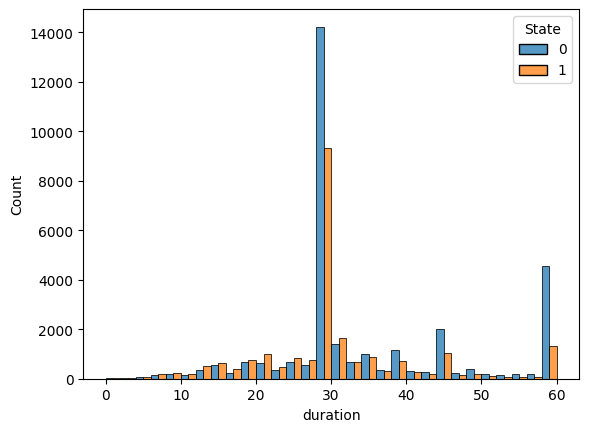

In [46]:
# plot data
sns.histplot(data=df_film,x='duration', hue='State',multiple='dodge', bins=30)  #cutoff: ~29 

<Axes: xlabel='duration', ylabel='Count'>

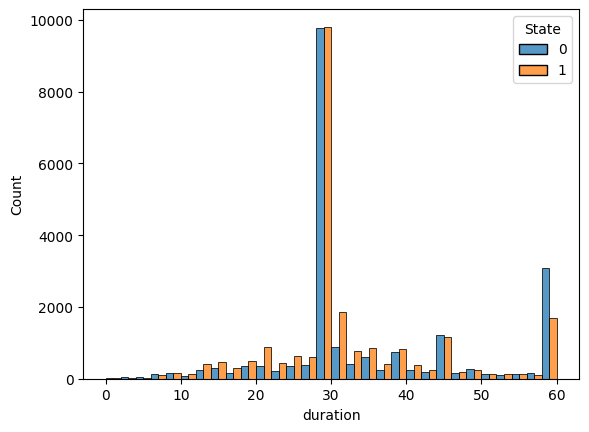

In [47]:
# plot data
sns.histplot(data=df_music,x='duration', hue='State',multiple='dodge', bins=30)  #cutoff: ~29 

<Axes: xlabel='duration', ylabel='Count'>

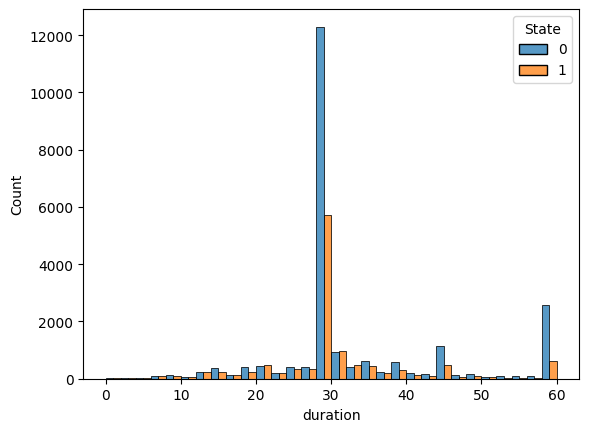

In [48]:
# plot data
sns.histplot(data=df_publishing,x='duration', hue='State',multiple='dodge', bins=30)  #cutoff: ~29 

<Axes: xlabel='Goal', ylabel='Count'>

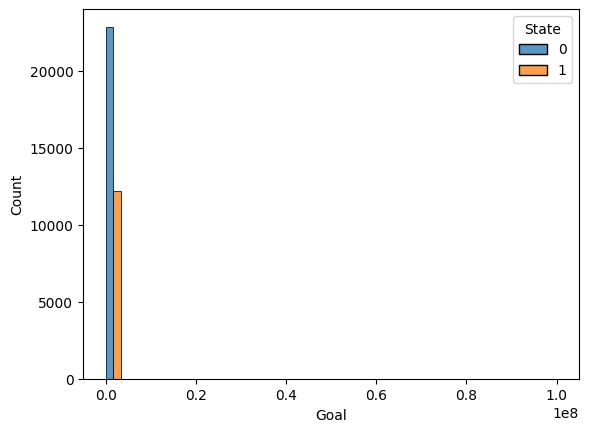

In [49]:
# plot data
sns.histplot(data=df_publishing,x='Goal', hue='State',multiple='dodge', bins=30)  #cutoff: ~29 

Set Cutoff for baseline model to 29 for all three models

## Final cleaning and feature selection

In [50]:
df.columns

Index(['ID', 'Name', 'Category', 'Subcategory', 'Country', 'Launched',
       'Deadline', 'Goal', 'Pledged', 'Backers', 'State', 'lon_launched',
       'time_launched', 'day_launched', 'day_launched_name', 'hour',
       'hour_sin', 'hour_cos', 'weekday', 'Monday', 'Saturday', 'Sunday',
       'Thursday', 'Tuesday', 'Wednesday', 'duration', 'goal_log'],
      dtype='object')

In [51]:
feature_list = ["goal_log", "duration"]
#feature_list = ["goal_log", "duration", "hour_sin", "hour_cos"]
#feature_list.extend(weekday_dummies.columns.to_list())
feature_list_weekday_categorical = ["goal_log", "duration", "weekday", "hour_sin", "hour_cos"]
feature_list_reduced = ["goal_log", "duration"]#, "weekday", "hour_sin", "hour_cos"]
feature_list

['goal_log', 'duration']

In [52]:
df[feature_list]

,goal_log,duration
0,6.907755,39
2,2.995732,8
4,7.549609,28
5,8.006368,17
6,5.298317,29
...,...,...
374310,3.583519,2
374400,5.602119,4
374458,5.298317,3
374530,5.521461,1


## Splitting the data

In [53]:
X = {}
Y = {}
for category in categories:
    df_temp = df[df.Category.isin([category])]
    X[category] = df_temp[feature_list]
    #X[category] = df_temp[.drop(columns='State')]
    Y[category] = df_temp.State

In [54]:
X_train = {}
X_test = {}
y_train = {}
y_test = {} 
for category in categories:
    X_train[category], X_test[category], y_train[category], y_test[category] = train_test_split(X[category], Y[category], test_size=0.20, random_state=42, shuffle=True, stratify=Y[category])
    # note: added shuffling (to account for ordered date within categories) and stratification (so that successful and failed projects have same share across test, train, and full data)

## Baseline model

In [55]:
y_baseline = {}
for category in categories:
    y_baseline[category] = X_test[category].duration.apply(lambda x:0 if x  > 29 else 1).values

In [56]:
recall_baseline = {}
for category in categories:
    recall_baseline[category] = recall_score(y_test[category], y_baseline[category], average='binary')  # Adjust 'average' as needed
    print(f"recall for category {category}: {recall_baseline[category]}")

recall for category Fashion: 0.6684587813620072
recall for category Art: 0.7392260334212841
recall for category Journalism: 0.702020202020202
recall for category Film & Video: 0.657167530224525
recall for category Publishing: 0.6709016393442623
recall for category Music: 0.6313227513227513
recall for category Photography: 0.6466049382716049
recall for category Technology: 0.5518316445830086
recall for category Theater: 0.6926070038910506
recall for category Crafts: 0.7772511848341233
recall for category Games: 0.6924309171005206
recall for category Comics: 0.6773080241587576
recall for category Food: 0.6867768595041323
recall for category Design: 0.5515439429928741
recall for category Dance: 0.6645021645021645


## Final cleaning + exploration: Outlier removal

We have identified the outliers BEFORE the split but do the removal AFTER the split.
Removing AFTER splitting is essential; we are not sure whether the identification should be before or after splitting or whether it doesn't matter. We leave it as it is.

In [57]:
df_train_wo_outlier = {}
y_train_wo_outlier = {}
X_train_wo_outlier = {}
for category in categories:
    df_train_wo_outlier[category] = X_train[category][(outliers_log_below[category] <= X_train[category].goal_log) & (X_train[category].goal_log <= outliers_log_above[category])]
    df_train_wo_outlier[category] = pd.merge(df_train_wo_outlier[category], y_train[category], left_index=True, right_index=True)
    y_train_wo_outlier[category] = df_train_wo_outlier[category]['State']
    X_train_wo_outlier[category] = df_train_wo_outlier[category].drop('State', axis=1)

#### data exploration AFTER outlier removal

<Axes: xlabel='goal_log', ylabel='Count'>

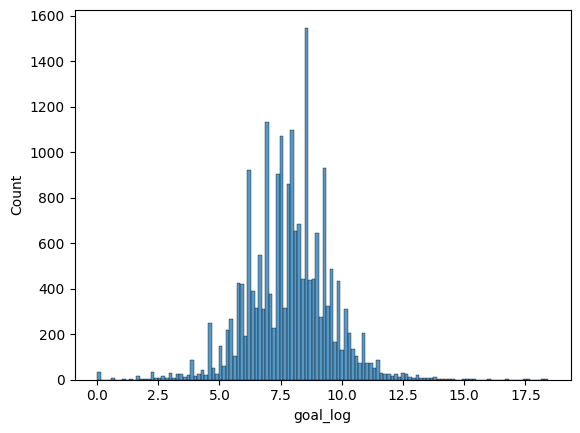

In [58]:
# BEFORE removal
sns.histplot(data = X_train["Art"], x = "goal_log")

<Axes: xlabel='goal_log', ylabel='Count'>

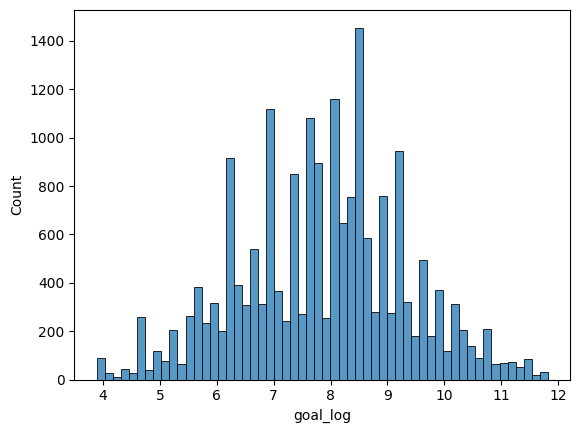

In [486]:
# AFTER removal
sns.histplot(data = X_train_wo_outlier["Art"], x = "goal_log")

## NEW

NOTE: additional changes _above_ this point: modified the train test split:
- added shuffling (to account for ordered date within categories) 
- added stratification (so that successful and failed projects have same share across test, train, and full data)

In [155]:
from sklearn.preprocessing import PolynomialFeatures, MinMaxScaler, StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV
from sklearn.model_selection import cross_val_score, cross_validate, StratifiedKFold
from sklearn.metrics import confusion_matrix, classification_report, recall_score, f1_score, make_scorer
#from imblearn.under_sampling import RandomUnderSampler


In [101]:
# we create dictionaries OF DICTIONARIES:
# goal: have e.g. y_pred for each model (level 1 of the dict) and within each model, for each category (level 2)
# we can then access e.g. y_pred[level 1: model = logistic with polynomial][level 2: category = Art]
#
# TRANSFORMERS & MODELS
models = {}
polynomial_features = {}
scalers = {}
#
# DATA
x_train_poly = {}
x_test_poly = {}
x_train_scaled = {}
x_test_scaled = {}
x_train_transformed = {} # for data transformation with scaling AND polynomials
x_test_transformed = {} # for data transformation with scaling AND polynomials
y_pred_train = {}
y_pred_test = {}
#
# METRICS
recalls_train = {}
recalls_test = {}
df_recalls = {}
f1_train = {}
f1_test = {}
df_f1 = {}
#
# SCORERS
recall_scorer = make_scorer(recall_score)
f1_scorer = make_scorer(f1_score)

In [62]:
features_to_scale = ["goal_log", "duration"]

### Logistic base: no polynomials, no scaling

In [490]:
# old 
model = "log_noPoly_noScale_old"
#
models[model] = {}
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
for category in categories:
    models[model][category] = LogisticRegression(class_weight="balanced")
    models[model][category].fit(X_train_wo_outlier[category], y_train_wo_outlier[category])
    #
    y_pred_train[model][category] = models[model][category].predict(X_train_wo_outlier[category])
    y_pred_test[model][category] = models[model][category].predict(X_test[category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]

,category,Recall train,Recall test
0,Fashion,0.500000,0.514337
1,Art,0.578192,0.600264
2,Journalism,0.558559,0.636364
3,Film & Video,0.611184,0.613126
4,Publishing,0.564081,0.573361
5,Music,0.566000,0.594074
6,Photography,0.539520,0.533951
7,Technology,0.536985,0.544037
8,Theater,0.617821,0.610895
9,Crafts,0.633999,0.616114


In [100]:
model = "log_noPoly_noScale"
#
models[model] = {}
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}

f1_train[model] = {}
f1_test[model] = {}

recall_scorer = make_scorer(recall_score)
f1_scorer = make_scorer(f1_score)

#
for category in categories:
    models[model][category] = LogisticRegression()
    models[model][category].fit(X_train_wo_outlier[category], y_train_wo_outlier[category])

     # Perform cross-validation
    cv_recall_scores = cross_val_score(
        models[model][category],
        X_train_wo_outlier[category],
        y_train_wo_outlier[category],
        scoring=recall_scorer,
        cv=5  # 5-fold cross-validation
    )

    print(f"Cross-validated Recall for {category}: {cv_recall_scores.mean()}")
# Perform cross-validation for F1 score
    cv_f1_scores = cross_val_score(
        models[model][category],
        X_train_wo_outlier[category],
        y_train_wo_outlier[category],
        scoring=f1_scorer,
        cv=5  # 5-fold cross-validation
    )
    print(f"Cross-validated Recall for {category}: {cv_f1_scores.mean()}")

    #
    y_pred_train[model][category] = models[model][category].predict(X_train_wo_outlier[category])
    y_pred_test[model][category] = models[model][category].predict(X_test[category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category]).round(4)
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category]).round(4)

    f1_train[model][category] = f1_score(y_train_wo_outlier[category], y_pred_train[model][category]).round(4)
    f1_test[model][category] = recall_score(y_test[category], y_pred_test[model][category]).round(4)

    # Confusion matrix for the current category
    cm = confusion_matrix(y_train_wo_outlier[category], y_pred_train[model][category])
    print(f"Confusion Matrix for {category}:\n{cm}")

#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values(),
    "F1 train": f1_train[model].values(),
    "F1 test": f1_test[model].values()
})
df_recalls[model]


Cross-validated Recall for Fashion: 0.0
Cross-validated Recall for Fashion: 0.0
Confusion Matrix for Fashion:
[[11217     0]
 [ 4404     0]]
Cross-validated Recall for Art: 0.4080095527468869
Cross-validated Recall for Art: 0.47135114665016936
Confusion Matrix for Art:
[[7973 2879]
 [5281 3633]]
Cross-validated Recall for Journalism: 0.0025806451612903226
Cross-validated Recall for Journalism: 0.005111873264739507
Confusion Matrix for Journalism:
[[2440    2]
 [ 773    4]]
Cross-validated Recall for Film & Video: 0.3526672762612412
Cross-validated Recall for Film & Video: 0.43096353471535115
Confusion Matrix for Film & Video:
[[19700  5182]
 [11819  6439]]
Cross-validated Recall for Publishing: 0.14689449640217242
Cross-validated Recall for Publishing: 0.2317554194261672
Confusion Matrix for Publishing:
[[16766  1154]
 [ 8046  1403]]
Cross-validated Recall for Music: 0.7101125157748169
Cross-validated Recall for Music: 0.6411526519307229
Confusion Matrix for Music:
[[ 7154  9421]
 [ 54

,category,Recall train,Recall test,F1 train,F1 test
0,Fashion,0.0000,0.0027,0.0000,0.0027
1,Art,0.4076,0.4301,0.4710,0.4301
2,Journalism,0.0051,0.0152,0.0102,0.0152
3,Film & Video,0.3527,0.3649,0.4310,0.3649
4,Publishing,0.1485,0.1566,0.2337,0.1566
5,Music,0.7088,0.7274,0.6404,0.7274
6,Photography,0.0629,0.0818,0.1147,0.0818
7,Technology,0.0000,0.0226,0.0000,0.0226
8,Theater,0.9351,0.9339,0.7970,0.9339
9,Crafts,0.1464,0.1635,0.2363,0.1635


Note: the models perform very well on the categories where success is very likely but very bad for categories with low success.

In [492]:
model = "log_noPoly_noScale"
#
models[model] = {}
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}

f1_train[model] = {}
f1_test[model] = {}
#
for category in categories:
    models[model][category] = LogisticRegression(class_weight="balanced")
    models[model][category].fit(X_train_wo_outlier[category], y_train_wo_outlier[category])

     # Perform cross-validation
    cv_recall_scores = cross_val_score(
        models[model][category],
        X_train_wo_outlier[category],
        y_train_wo_outlier[category],
        scoring=recall_scorer,
        cv=5  # 5-fold cross-validation
    )

    print(f"Cross-validated Recall for {category}: {cv_recall_scores.mean()}")
# Perform cross-validation for F1 score
    cv_f1_scores = cross_val_score(
        models[model][category],
        X_train_wo_outlier[category],
        y_train_wo_outlier[category],
        scoring=f1_scorer,
        cv=5  # 5-fold cross-validation
    )
    print(f"Cross-validated F1 for {category}: {cv_f1_scores.mean()}")
    #
    y_pred_train[model][category] = models[model][category].predict(X_train_wo_outlier[category])
    y_pred_test[model][category] = models[model][category].predict(X_test[category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category]).round(4)
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category]).round(4)

    f1_train[model][category] = f1_score(y_train_wo_outlier[category], y_pred_train[model][category]).round(4)
    f1_test[model][category] = recall_score(y_test[category], y_pred_test[model][category]).round(4)
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values(),
    "F1 train": f1_train[model].values(),
    "F1 test": f1_test[model].values()
})
df_recalls[model]

Cross-validated Recall for Fashion: 0.49931302239191
Cross-validated F1 for Fashion: 0.378311065983264
Cross-validated Recall for Art: 0.5783028137673865
Cross-validated F1 for Art: 0.5606032280921113
Cross-validated Recall for Journalism: 0.5598842018196857
Cross-validated F1 for Journalism: 0.39179166823532996
Cross-validated Recall for Film & Video: 0.6117316505883098
Cross-validated F1 for Film & Video: 0.566330276232808
Cross-validated Recall for Publishing: 0.5648209489077672
Cross-validated F1 for Publishing: 0.492951482077172
Cross-validated Recall for Music: 0.5673934501438227
Cross-validated F1 for Music: 0.5753589665636889
Cross-validated Recall for Photography: 0.5367549463979084
Cross-validated F1 for Photography: 0.4558508381174553
Cross-validated Recall for Technology: 0.5339912087912089
Cross-validated F1 for Technology: 0.3720804489760519
Cross-validated Recall for Theater: 0.6174273569786077
Cross-validated F1 for Theater: 0.676480289866887
Cross-validated Recall for 

,category,Recall train,Recall test,F1 train,F1 test
0,Fashion,0.5000,0.5143,0.3790,0.5143
1,Art,0.5782,0.6003,0.5608,0.6003
2,Journalism,0.5586,0.6364,0.3945,0.6364
3,Film & Video,0.6112,0.6131,0.5661,0.6131
4,Publishing,0.5641,0.5734,0.4928,0.5734
5,Music,0.5660,0.5941,0.5746,0.5941
6,Photography,0.5395,0.5340,0.4577,0.5340
7,Technology,0.5370,0.5440,0.3722,0.5440
8,Theater,0.6178,0.6109,0.6766,0.6109
9,Crafts,0.6340,0.6161,0.4808,0.6161


After balancing, the models perform all equally moderate.

### Logistic: with polynomials degree 2, no scaling

NOTE: this also creates polynomials for weekday, hours, etc. - does not make sense!!

note: the output asks us to either increase the number of iterations (which doesn't improve anything) or to add scaling (which we try next)

In [493]:
model = "log_Poly2_noScale"
#
models[model] = {}
polynomial_features[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#
for category in categories:
    #
    # transformation 1: polynomials
    # here: degree 2
    polynomial_features[model][category] = PolynomialFeatures(degree=2, include_bias=False)
    x_train_poly[model][category] = polynomial_features[model][category].fit_transform(X_train_wo_outlier[category])
    x_test_poly[model][category] = polynomial_features[model][category].transform(X_test[category])
    #
    # transformation 2: scaling
    # here: none
    x_train_scaled[model][category] = x_train_poly[model][category]
    x_test_scaled[model][category] = x_test_poly[model][category]
    #
    # transformation: final
    x_train_transformed[model][category] = x_train_scaled[model][category]
    x_test_transformed[model][category] = x_test_scaled[model][category]
    #
    # regression
    models[model][category] = LogisticRegression(class_weight="balanced")
    models[model][category].fit(x_train_transformed[model][category], y_train_wo_outlier[category])

# Perform cross-validation
    cv_recall_scores = cross_val_score(
        models[model][category],
        x_train_transformed[model][category],
        y_train_wo_outlier[category],
        scoring=recall_scorer,
        cv=5  # 5-fold cross-validation
    )

    print(f"Cross-validated Recall for {category}: {cv_recall_scores.mean()}")
# Perform cross-validation for F1 score
    cv_f1_scores = cross_val_score(
        models[model][category],
        x_train_transformed[model][category],
        y_train_wo_outlier[category],
        scoring=f1_scorer,
        cv=5  # 5-fold cross-validation
    )
    print(f"Cross-validated F1 for {category}: {cv_f1_scores.mean()}")


    #
    y_pred_train[model][category] = models[model][category].predict(x_train_transformed[model][category])
    y_pred_test[model][category] = models[model][category].predict(x_test_transformed[model][category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])

        # Confusion matrix for the current category
    cm = confusion_matrix(y_train_wo_outlier[category], y_pred_train[model][category])
    print(f"Confusion Matrix for {category}:\n{cm}")
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]

Cross-validated Recall for Fashion: 0.5792454339077494
Cross-validated F1 for Fashion: 0.4066999888361834
Confusion Matrix for Fashion:
[[5583 5634]
 [1831 2573]]
Cross-validated Recall for Art: 0.6529061412404094
Cross-validated F1 for Art: 0.5900540864046199
Confusion Matrix for Art:
[[5854 4998]
 [3088 5826]]
Cross-validated Recall for Journalism: 0.6216294458229943
Cross-validated F1 for Journalism: 0.3940638704422196
Confusion Matrix for Journalism:
[[1242 1200]
 [ 290  487]]
Cross-validated Recall for Film & Video: 0.6749367230631647
Cross-validated F1 for Film & Video: 0.5863224152629265
Confusion Matrix for Film & Video:
[[13446 11436]
 [ 5951 12307]]
Cross-validated Recall for Publishing: 0.6369983278294554
Cross-validated F1 for Publishing: 0.507972597264026
Confusion Matrix for Publishing:
[[9772 8148]
 [3448 6001]]
Cross-validated Recall for Music: 0.632991781438962
Cross-validated F1 for Music: 0.6104911650679655
Confusion Matrix for Music:
[[ 8448  8127]
 [ 6958 11701]]
C

,category,Recall train,Recall test
0,Fashion,0.584242,0.595878
1,Art,0.653579,0.674142
2,Journalism,0.626770,0.666667
3,Film & Video,0.674061,0.671632
4,Publishing,0.635094,0.643033
5,Music,0.627097,0.656085
6,Photography,0.604404,0.583333
7,Technology,0.584366,0.604053
8,Theater,0.696105,0.687938
9,Crafts,0.676346,0.663507


In [494]:
df_recalls[model]["Recall test"].mean()

0.6476581242061873

3 degrees:

In [495]:
model = "log_Poly2_noScale"
#
models[model] = {}
polynomial_features[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#
for category in categories:
    #
    # transformation 1: polynomials
    # here: degree 2
    polynomial_features[model][category] = PolynomialFeatures(degree=3, include_bias=False)
    x_train_poly[model][category] = polynomial_features[model][category].fit_transform(X_train_wo_outlier[category])
    x_test_poly[model][category] = polynomial_features[model][category].transform(X_test[category])
    #
    # transformation 2: scaling
    # here: none
    x_train_scaled[model][category] = x_train_poly[model][category]
    x_test_scaled[model][category] = x_test_poly[model][category]
    #
    # transformation: final
    x_train_transformed[model][category] = x_train_scaled[model][category]
    x_test_transformed[model][category] = x_test_scaled[model][category]
    #
    # regression
    models[model][category] = LogisticRegression(class_weight="balanced")
    models[model][category].fit(x_train_transformed[model][category], y_train_wo_outlier[category])

# Perform cross-validation
    cv_recall_scores = cross_val_score(
        models[model][category],
        x_train_transformed[model][category],
        y_train_wo_outlier[category],
        scoring=recall_scorer,
        cv=5  # 5-fold cross-validation
    )

    print(f"Cross-validated Recall for {category}: {cv_recall_scores.mean()}")
# Perform cross-validation for F1 score
    cv_f1_scores = cross_val_score(
        models[model][category],
        x_train_transformed[model][category],
        y_train_wo_outlier[category],
        scoring=f1_scorer,
        cv=5  # 5-fold cross-validation
    )
    print(f"Cross-validated F1 for {category}: {cv_f1_scores.mean()}")


    #
    y_pred_train[model][category] = models[model][category].predict(x_train_transformed[model][category])
    y_pred_test[model][category] = models[model][category].predict(x_test_transformed[model][category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]


Cross-validated Recall for Fashion: 0.6060308533691053
Cross-validated F1 for Fashion: 0.4083006164483375


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentati

Cross-validated Recall for Art: 0.7079877732896989


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentati

Cross-validated F1 for Art: 0.6058769381209359


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated Recall for Journalism: 0.6435235732009925


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated F1 for Journalism: 0.38962190344856595


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated Recall for Film & Video: 0.694875085611738


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated F1 for Film & Video: 0.5888099971067973


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated Recall for Publishing: 0.6725576366656304


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated F1 for Publishing: 0.517665958515356


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated Recall for Music: 0.6547504569777333


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated F1 for Music: 0.6208982088687425
Cross-validated Recall for Photography: 0.5867224602818556
Cross-validated F1 for Photography: 0.4594871147789387
Cross-validated Recall for Technology: 0.6249570429570429
Cross-validated F1 for Technology: 0.3993671231684198
Cross-validated Recall for Theater: 0.7167599625268081
Cross-validated F1 for Theater: 0.7270257457979385


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentati

Cross-validated Recall for Crafts: 0.7071811773322347


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentati

Cross-validated F1 for Crafts: 0.47619099344961036


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentati

Cross-validated Recall for Games: 0.7007997076639823


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Cross-validated F1 for Games: 0.599083135558862
Cross-validated Recall for Comics: 0.6971571223056371
Cross-validated F1 for Comics: 0.6890800011776597


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentati

Cross-validated Recall for Food: 0.6897486671744097


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentati

Cross-validated F1 for Food: 0.4685031336512438
Cross-validated Recall for Design: 0.6191500312571381
Cross-validated F1 for Design: 0.541244533880771
Cross-validated Recall for Dance: 0.7006027129487028
Cross-validated F1 for Dance: 0.7154178891316609


,category,Recall train,Recall test
0,Fashion,0.571299,0.577957
1,Art,0.703051,0.698769
2,Journalism,0.662806,0.727273
3,Film & Video,0.708237,0.706822
4,Publishing,0.624405,0.633607
5,Music,0.656359,0.670476
6,Photography,0.573339,0.541667
7,Technology,0.629948,0.628215
8,Theater,0.717349,0.712840
9,Crafts,0.709014,0.696682


In [496]:
df_recalls[model]["Recall test"].mean()

0.6686571836548338

Note: The mean recall score was better (0.65 vs. 0.63) for the polynomial model to 2nd degree than 3rd degree.

### Logistic: no polynomials, with Standard Scaler

In [497]:
model = "log_noPoly_StandardScale"
#
models[model] = {}
#polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#
for category in categories:
    #
    # transformation 1: polynomials
    # here: none
    x_train_poly[model][category] = X_train_wo_outlier[category]
    x_test_poly[model][category] = X_test[category]
    #
    # transformation 2: scaling
    # here: StandardScaler
    scalers[model][category] = StandardScaler()
    # scale only columns/features to be scaled, not all!
    x_train_scaled[model][category] = scalers[model][category].fit_transform(x_train_poly[model][category][features_to_scale])
    x_test_scaled[model][category]= scalers[model][category].transform(x_test_poly[model][category][features_to_scale])
    #
    # merge scaled and unscaled features back into a single dataframe
    x_train_transformed[model][category] = np.concatenate([x_train_scaled[model][category], x_train_poly[model][category].drop(features_to_scale, axis=1)], axis=1)
    x_test_transformed[model][category] = np.concatenate([x_test_scaled[model][category], x_test_poly[model][category].drop(features_to_scale, axis=1)], axis=1)
    #
    models[model][category] = LogisticRegression()
    models[model][category].fit(x_train_transformed[model][category], y_train_wo_outlier[category])
    #
    y_pred_train[model][category] = models[model][category].predict(x_train_transformed[model][category])
    y_pred_test[model][category] = models[model][category].predict(x_test_transformed[model][category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]


,category,Recall train,Recall test
0,Fashion,0.000000,0.002688
1,Art,0.407561,0.430079
2,Journalism,0.005148,0.015152
3,Film & Video,0.352667,0.364853
4,Publishing,0.148481,0.156557
5,Music,0.708827,0.727407
6,Photography,0.062918,0.081790
7,Technology,0.000000,0.022603
8,Theater,0.935090,0.933852
9,Crafts,0.146400,0.163507


Let's have a look at what the scaled data looks like. Take the example of the categoriy "Art":

In [498]:
# pre scaling
X_train_wo_outlier["Art"]

,goal_log,duration
367322,9.210340,29
238088,6.745236,24
4496,7.824046,29
356613,7.906179,29
70987,8.699515,29
...,...,...
107564,6.907755,59
57861,6.907755,15
190074,8.294050,20
204373,8.517193,25


In [499]:
# post scaling: note that weekday and hour are not scaled, but goal and duration are
# BUT: did the model lose the information that weekday is a categorical instead of a numerical feature?
pd.DataFrame(x_train_transformed["log_noPoly_StandardScale"]["Art"])

,0,1
0,0.918958,-0.141252
1,-0.758746,-0.561493
2,-0.024528,-0.141252
3,0.031370,-0.141252
4,0.571300,-0.141252
...,...,...
19761,-0.648138,2.380191
19762,-0.648138,-1.317926
19763,0.295348,-0.897686
19764,0.447215,-0.477445


### Logistic: no polynomials, with MinMax Scaler

In [500]:
model = "log_noPoly_MinMaxScale"
#
models[model] = {}
#polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#
for category in categories:
    #
    # transformation 1: polynomials
    # here: none
    x_train_poly[model][category] = X_train_wo_outlier[category]
    x_test_poly[model][category] = X_test[category]
    #
    # transformation 2: scaling
    # here: MinMaxScaler
    scalers[model][category] = MinMaxScaler()
    # scale only columns/features to be scaled, not all!
    x_train_scaled[model][category] = scalers[model][category].fit_transform(x_train_poly[model][category][features_to_scale])
    x_test_scaled[model][category]= scalers[model][category].transform(x_test_poly[model][category][features_to_scale])
    #
    # merge scaled and unscaled features back into a single dataframe
    x_train_transformed[model][category] = np.concatenate([x_train_scaled[model][category], x_train_poly[model][category].drop(features_to_scale, axis=1)], axis=1)
    x_test_transformed[model][category] = np.concatenate([x_test_scaled[model][category], x_test_poly[model][category].drop(features_to_scale, axis=1)], axis=1)
    #
    models[model][category] = LogisticRegression()
    models[model][category].fit(x_train_transformed[model][category], y_train_wo_outlier[category])
    #
    y_pred_train[model][category] = models[model][category].predict(x_train_transformed[model][category])
    y_pred_test[model][category] = models[model][category].predict(x_test_transformed[model][category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]


,category,Recall train,Recall test
0,Fashion,0.000000,0.002688
1,Art,0.407337,0.430079
2,Journalism,0.001287,0.015152
3,Film & Video,0.352503,0.364637
4,Publishing,0.147529,0.156148
5,Music,0.708934,0.727619
6,Photography,0.060165,0.077160
7,Technology,0.000000,0.021044
8,Theater,0.935484,0.933852
9,Crafts,0.129462,0.151659


### Logistic: with polynomials degree 2, with Standard Scaler

In [501]:
model = "log_Poly2_StandardScale"
#
models[model] = {}
polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#
for category in categories:
    #
    # transformation 1: polynomials
    # here: degree 2
    polynomial_features[model][category] = PolynomialFeatures(degree=2, include_bias=False)
    x_train_poly[model][category] = polynomial_features[model][category].fit_transform(X_train_wo_outlier[category])
    x_test_poly[model][category] = polynomial_features[model][category].transform(X_test[category])
    #
    # transformation 2: scaling
    # here: StandardScaler
    scalers[model][category] = StandardScaler()
    # this time we scale all features because we now also have mixed and squared terms!
    x_train_scaled[model][category] = scalers[model][category].fit_transform(x_train_poly[model][category])
    x_test_scaled[model][category] = scalers[model][category].transform(x_test_poly[model][category])
    #
    # merge scaled and unscaled features back into a single dataframe
    x_train_transformed[model][category] = x_train_scaled[model][category] #np.concatenate([x_train_scaled[model][category], x_train_poly[model][category].drop(features_to_scale, axis=1)], axis=1)
    x_test_transformed[model][category] = x_test_scaled[model][category] #np.concatenate([x_test_scaled[model][category], x_test_poly[model][category].drop(features_to_scale, axis=1)], axis=1)
    #
    models[model][category] = LogisticRegression(class_weight="balanced")
    models[model][category].fit(x_train_transformed[model][category], y_train_wo_outlier[category])
    #
    y_pred_train[model][category] = models[model][category].predict(x_train_transformed[model][category])
    y_pred_test[model][category] = models[model][category].predict(x_test_transformed[model][category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})

print(df_recalls[model]["Recall test"].mean())
df_recalls[model]

0.648899954065826


,category,Recall train,Recall test
0,Fashion,0.559264,0.561828
1,Art,0.675567,0.686895
2,Journalism,0.604891,0.656566
3,Film & Video,0.700953,0.693869
4,Publishing,0.630225,0.638115
5,Music,0.691463,0.695661
6,Photography,0.518285,0.521605
7,Technology,0.582167,0.601715
8,Theater,0.713611,0.712062
9,Crafts,0.628554,0.609005


problem: the polynomial transformation removes the original column names (I think) and/or adds new columns from the squared terms, so the method of naming which columns to scale afterwards no longer works

In [502]:
pd.DataFrame(x_train_poly["log_Poly2_StandardScale"]["Fashion"])

,0,1,2,3,4
0,9.798127,29.0,96.003293,284.145684,841.0
1,8.006368,29.0,64.101922,232.184659,841.0
2,9.903488,29.0,98.079066,287.201139,841.0
3,9.337854,14.0,87.195512,130.729952,196.0
4,8.160518,29.0,66.594058,236.655029,841.0
...,...,...,...,...,...
15616,5.521461,29.0,30.486531,160.122367,841.0
15617,7.600902,29.0,57.773718,220.426171,841.0
15618,6.214608,29.0,38.621354,180.223635,841.0
15619,9.210340,29.0,84.830370,267.099871,841.0


### Logistic: with polynomials degree 2, with Standard Scaler; scaling BEFORE poly

In [69]:
features_to_scale

['goal_log', 'duration']

In [70]:
df.columns

Index(['ID', 'Name', 'Category', 'Subcategory', 'Country', 'Launched',
       'Deadline', 'Goal', 'Pledged', 'Backers', 'State', 'lon_launched',
       'time_launched', 'day_launched', 'day_launched_name', 'hour',
       'hour_sin', 'hour_cos', 'weekday', 'Monday', 'Saturday', 'Sunday',
       'Thursday', 'Tuesday', 'Wednesday', 'duration', 'goal_log'],
      dtype='object')

In [179]:
model = "log_Poly2_StandardScale_scalefirst"
#
models[model] = {}
polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
cross_recall_scores = {}
#
#
for category in categories:
    #
    # transformation 1: scaling
    # here: StandardScaler
    scalers[model][category] = StandardScaler()
    # this time we scale all features because we now also have mixed and squared terms!
    x_train_scaled[model][category] = scalers[model][category].fit_transform(X_train_wo_outlier[category][features_to_scale])#x_train_poly[model][category])
    x_test_scaled[model][category] = scalers[model][category].transform(X_test[category][features_to_scale])
    #
    # merge scaled and unscaled features back into a single dataframe
    x_train_transformed[model][category] = np.concatenate([x_train_scaled[model][category], X_train_wo_outlier[category].drop(features_to_scale, axis=1)], axis=1)
    x_test_transformed[model][category] = np.concatenate([x_test_scaled[model][category], X_test[category].drop(features_to_scale, axis=1)], axis=1)
    #
    # transformation 1: polynomials
    # here: degree 2
    polynomial_features[model][category] = PolynomialFeatures(degree=3, include_bias=False) # see hyperparameters for logisticregression below
    x_train_poly[model][category] = polynomial_features[model][category].fit_transform(x_train_transformed[model][category])
    x_test_poly[model][category] = polynomial_features[model][category].transform(x_test_transformed[model][category])
    #
    models[model][category] = LogisticRegression(penalty="l1", solver="liblinear", class_weight="balanced", l1_ratio = None, C = 1, max_iter = 100) # optimal so far: l2, lbfgs, poly 6; or: l1/l2, liblinear/newton-cholesky, degree 3; 
    models[model][category].fit(x_train_poly[model][category], y_train_wo_outlier[category])
    #
    # add cross validation on TRAIN data
    # UNcomment the following to get cross val scores. Finding: not much of a difference across folds, i.e. all good
    #"""
    cross_recall_scores[category] = cross_val_score(
        models[model][category],
        x_train_poly[model][category],
        y_train_wo_outlier[category],
        scoring=recall_scorer,
        cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # 5-fold cross-validation
    )
    #"""
    #
    y_pred_train[model][category] = models[model][category].predict(x_train_poly[model][category])
    y_pred_test[model][category] = models[model][category].predict(x_test_poly[model][category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
    # 
    # show progress
    print(f"Category {category} is done.")
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})

print(df_recalls[model]["Recall test"].mean())
df_recalls[model]

Category Fashion is done.
Category Art is done.
Category Journalism is done.
Category Film & Video is done.
Category Publishing is done.
Category Music is done.
Category Photography is done.
Category Technology is done.
Category Theater is done.
Category Crafts is done.
Category Games is done.
Category Comics is done.
Category Food is done.
Category Design is done.
Category Dance is done.
0.7006725659684008


,category,Recall train,Recall test
0,Fashion,0.764986,0.744624
1,Art,0.706978,0.720317
2,Journalism,0.678250,0.752525
3,Film & Video,0.726969,0.728411
4,Publishing,0.669700,0.673361
5,Music,0.744949,0.753651
6,Photography,0.627605,0.589506
7,Technology,0.670732,0.668745
8,Theater,0.716955,0.710506
9,Crafts,0.629159,0.611374


In [152]:
for category in categories:
    print(cross_recall_scores[category])

[0.75255392 0.78522727 0.75709421 0.78093076 0.76163451]
[0.71620864 0.69584736 0.71733034 0.70386988 0.70555244]
[0.68387097 0.62580645 0.65384615 0.60897436 0.67741935]
[0.72938921 0.72747193 0.73384447 0.71631982 0.72891566]
[0.67195767 0.65925926 0.68253968 0.66296296 0.66490206]
[0.74598071 0.74222937 0.74062165 0.74303323 0.74993299]
[0.60510806 0.64047151 0.61493124 0.6476378  0.62204724]
[0.64635365 0.69230769 0.651      0.699      0.672     ]
[0.71484759 0.73156342 0.70894789 0.71878073 0.70374016]
[0.64048338 0.65757576 0.55757576 0.60120846 0.6858006 ]
[0.68087318 0.67307692 0.67671518 0.67047817 0.68226729]
[0.62967033 0.63076923 0.63476348 0.69306931 0.61936194]
[0.78021978 0.77887789 0.779978   0.76483516 0.79230769]
[0.65257353 0.64338235 0.66523605 0.64806867 0.6629902 ]
[0.75543478 0.75271739 0.75749319 0.71934605 0.77656676]


In [106]:
cross_recall_scores["Dance"]

array([0.79076087, 0.76902174, 0.76839237, 0.77384196, 0.79564033])

In [101]:
pd.DataFrame(cross_recall_scores[category] for category in categories)

,0,1,2,3,4
0,0.644722,0.632955,0.620885,0.654938,0.636776
1,0.698822,0.702581,0.681436,0.711722,0.712844
2,0.574194,0.606452,0.615385,0.608974,0.664516
3,0.718981,0.714051,0.722618,0.685652,0.720153
4,0.689418,0.624339,0.662963,0.645503,0.641080
5,0.710075,0.718650,0.753215,0.714898,0.699008
6,0.644401,0.624754,0.607073,0.594488,0.622047
7,0.704296,0.675325,0.724000,0.702000,0.706000
8,0.683382,0.728614,0.680433,0.692232,0.728346
9,0.631420,0.621212,0.633333,0.673716,0.667674


### Logistic: with poly, with standard scaler, scale first, add gridsearch (and maybe later also loop over poly degree)

In [158]:
model = "log_poly_scale_grid"
#
values_C = np.logspace(0, 4, num=10) 
param_grid = {"penalty" :           ["l1", "l2", "elasticnet", None],
              "class_weight"    :   ["balanced", None],
              "solver"  :           ["lbfgs", "liblinear", "newton-cg", "newton-cholesky", "sag", "saga"],
              "C"       :           values_C,
              "l1_ratio":           [.1, .5, .9, None],
              "n_jobs"  :           [-1]           
              }
#
models[model] = {}
polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
cross_recall_scores = {}
#
#
for category in categories:
    #
    # transformation 1: scaling
    # here: StandardScaler
    scalers[model][category] = StandardScaler()
    # this time we scale all features because we now also have mixed and squared terms!
    x_train_scaled[model][category] = scalers[model][category].fit_transform(X_train_wo_outlier[category][features_to_scale])#x_train_poly[model][category])
    x_test_scaled[model][category] = scalers[model][category].transform(X_test[category][features_to_scale])
    #
    # merge scaled and unscaled features back into a single dataframe
    x_train_transformed[model][category] = np.concatenate([x_train_scaled[model][category], X_train_wo_outlier[category].drop(features_to_scale, axis=1)], axis=1)
    x_test_transformed[model][category] = np.concatenate([x_test_scaled[model][category], X_test[category].drop(features_to_scale, axis=1)], axis=1)
    #
    # transformation 1: polynomials
    # here: degree 2
    polynomial_features[model][category] = PolynomialFeatures(degree=3, include_bias=False) # see hyperparameters for logisticregression below
    x_train_poly[model][category] = polynomial_features[model][category].fit_transform(x_train_transformed[model][category])
    x_test_poly[model][category] = polynomial_features[model][category].transform(x_test_transformed[model][category])
    #
    models[model][category] = GridSearchCV(LogisticRegression(), param_grid, scoring = "recall", cv = 5, n_jobs = -1)
    #models[model][category] = LogisticRegression(penalty="l2", solver="liblinear", class_weight="balanced", max_iter = 100) # optimal so far: l2, lbfgs, poly 6; or: l1/l2, liblinear/newton-cholesky, degree 3; 
    models[model][category].fit(x_train_poly[model][category], y_train_wo_outlier[category])
    #
    # add cross validation on TRAIN data
    # UNcomment the following to get cross val scores. Finding: not much of a difference across folds, i.e. all good
    """
    cross_recall_scores[category] = cross_val_score(
        models[model][category],
        x_train_poly[model][category],
        y_train_wo_outlier[category],
        scoring=recall_scorer,
        cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # 5-fold cross-validation
    )
    """
    #
    y_pred_train[model][category] = models[model][category].predict(x_train_poly[model][category])
    y_pred_test[model][category] = models[model][category].predict(x_test_poly[model][category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
    # 
    # show progress
    print(f"Category {category} is done.")
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})

print(df_recalls[model]["Recall test"].mean())
df_recalls[model]

/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Fashion is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Art is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l

Category Journalism is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Film & Video is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Publishing is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Music is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Photography is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l

Category Technology is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Theater is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Crafts is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Games is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Comics is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l

Category Food is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l

Category Design is done.


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1165: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1211: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 

Category Dance is done.
0.7473364952110902


/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
4100 fits failed out of a total of 9600.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
400 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/colin/Nextcloud/Coding/projects/kickstarter/kickstarter-project/.venv/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver 

,category,Recall train,Recall test
0,Fashion,0.765213,0.744624
1,Art,0.706978,0.720317
2,Journalism,0.680824,0.752525
3,Film & Video,0.726969,0.728411
4,Publishing,0.669700,0.673361
5,Music,0.809583,0.820317
6,Photography,0.633504,0.597222
7,Technology,0.670732,0.668745
8,Theater,0.920535,0.915175
9,Crafts,0.629159,0.611374


In [178]:
models["log_poly_scale_grid"]["Photography"].best_params_

{'C': 464.15888336127773,
 'class_weight': 'balanced',
 'l1_ratio': None,
 'n_jobs': -1,
 'penalty': 'l1',
 'solver': 'liblinear'}

In [177]:
for category in categories:
    print(category, models["log_poly_scale_grid"][category].best_params_["C"])

Fashion 1.0
Art 1.0
Journalism 1.0
Film & Video 1.0
Publishing 1.0
Music 1.0
Photography 464.15888336127773
Technology 1.0
Theater 1.0
Crafts 1.0
Games 1.0
Comics 1.0
Food 1.0
Design 1.0
Dance 1.0


In [159]:
df_recalls["log_poly_scale_grid"]["Recall test"].mean()

0.7473364952110902

## NEWNEW

In [64]:
from mpl_toolkits.mplot3d import Axes3D

In [83]:
def myplot(model, category):
    #model_data = models[model][category]
    # create Kickstarter parameter grid for pairs of goal_log (!) and duration
    list_goal_log = np.arange(0,16,0.5) 
    list_duration = np.arange(0,61) 
    project_parameters = []
    #
    for goal in list_goal_log:
        for duration in list_duration:
            project_parameters.append([goal, duration])
    df_param = pd.DataFrame(project_parameters, columns = ["goal_log", "duration"])
    #
    # apply scaling and polynomials to the Kickstarter parameter valuers
    # 1: scaling
    df_param_scaled = scalers[model][category].transform(df_param)
    # 2: polynomial
    df_param_poly = polynomial_features[model][category].transform(df_param_scaled)
    # predict success change
    kick_predict = models[model][category].predict_proba(df_param_poly)[:,1] # this gives us the second column, i.e. class = 1/success
    # add prediction to project parameter grid
    df_param["success_chance"] = kick_predict
    df_param["goal_no_log"] = np.exp(df_param.goal_log)
    #
    # create plot
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    ax.scatter(df_param["goal_log"], df_param["duration"], df_param["success_chance"], c = df_param["success_chance"])#, cmap="OrRd")
    ax.set_xlabel("goal (in USD), log-displayed")
    x_ax_labels = [1, 10, 100, 1000, 10000, 100000, 1000000]
    x_ax_label_locations = np.log(x_ax_labels)
    plt.xticks(x_ax_label_locations, x_ax_labels)
    ax.set_ylabel("duration (in days)")
    ax.set_zlabel("success chance")
    ax.set_title(category)
    plt.show()

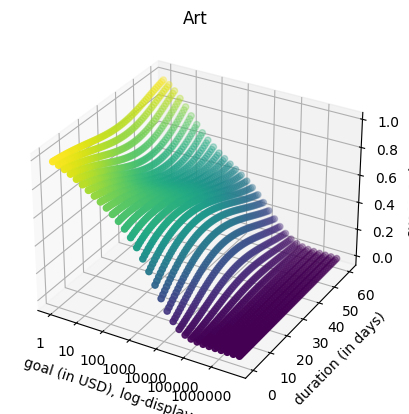

In [180]:
myplot("log_poly_scale_grid", "Art")

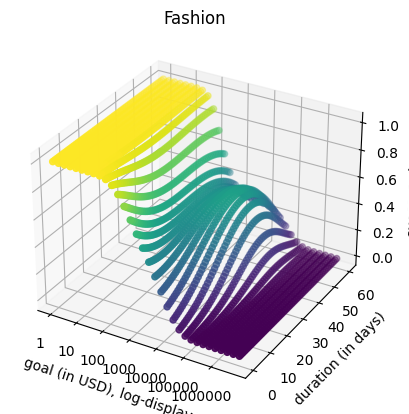

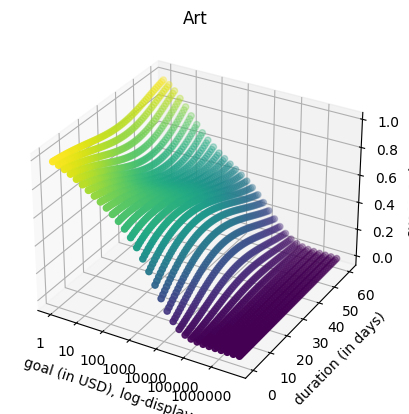

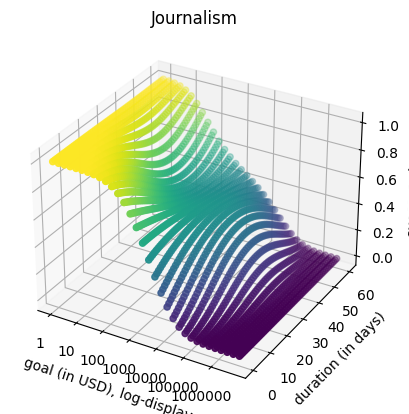

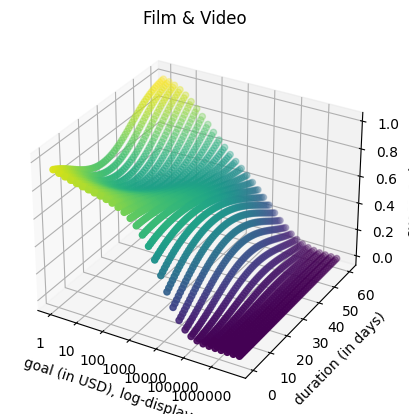

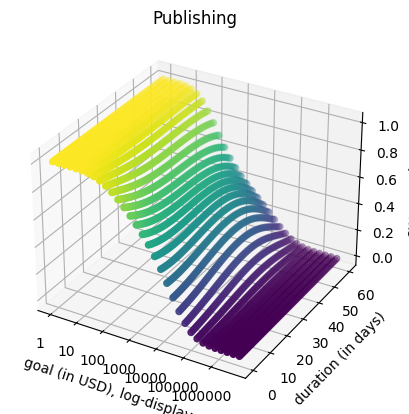

...

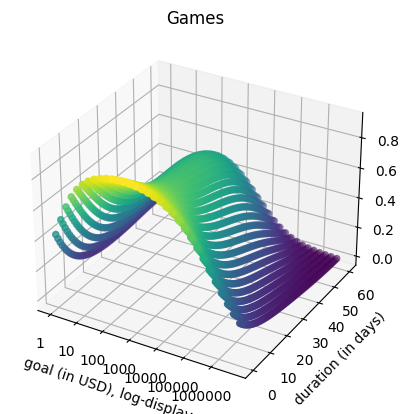

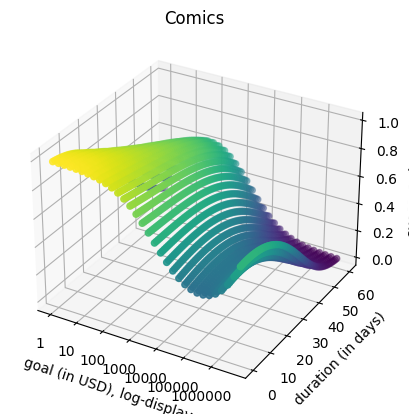

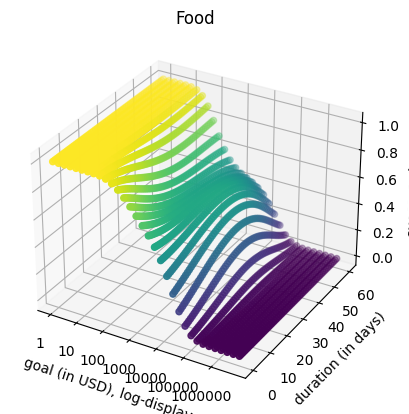

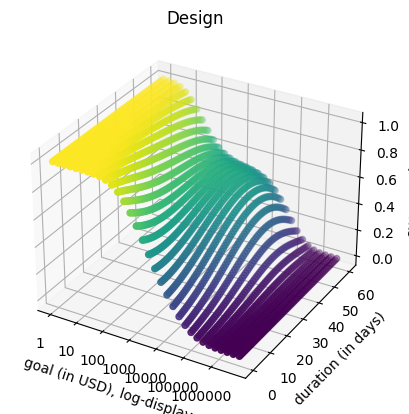

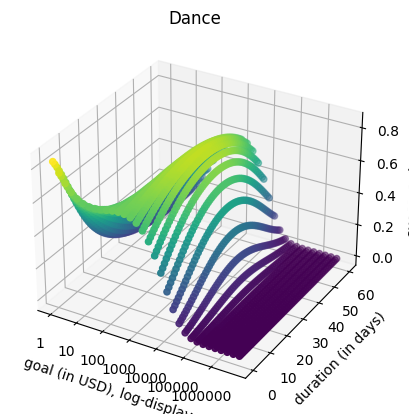

In [181]:
for category in categories:
    myplot("log_poly_scale_grid", category)

In [531]:
models["log_Poly2_StandardScale_scalefirst"]["Art"]

LogisticRegression(class_weight='balanced')

In [609]:
X_test["Art"].describe()

,goal_log,duration
count,5066.000000,5066.000000
mean,7.840254,30.721871
std,1.732706,11.865794
min,0.000000,0.000000
25%,6.856462,28.000000
50%,7.966226,29.000000
75%,8.922658,31.000000
max,18.420681,60.000000


In [619]:
# create Kickstarter parameter grid for pairs of goal_log (!) and duration
list_goal_log = list(range(0,16))
list_duration = list(range(0,61))
project_parameters = []
#
for goal in list_goal_log:
    for duration in list_duration:
        project_parameters.append([goal, duration])
df_param = pd.DataFrame(project_parameters, columns = ["goal_log", "duration"])
#
df_param

,goal_log,duration
0,0,0
1,0,1
2,0,2
3,0,3
4,0,4
...,...,...
971,15,56
972,15,57
973,15,58
974,15,59


In [620]:
# apply scaling and polynomials to the Kickstarter parameter valuers
# 1: scaling
df_param_scaled = scalers["log_Poly2_StandardScale_scalefirst"]["Art"].transform(df_param)
# 2: polynomial
df_param_poly = polynomial_features["log_Poly2_StandardScale_scalefirst"]["Art"].transform(df_param_scaled)

In [621]:
# predict success change
kick_predict = models["log_Poly2_StandardScale_scalefirst"]["Art"].predict_proba(df_param_poly)[:,1] # this gives us the second column, i.e. class = 1/success
# add prediction to project parameter grid
df_param["success_chance"] = kick_predict
df_param["goal_no_log"] = np.exp(df_param.goal_log)

In [622]:
df_param

,goal_log,duration,success_chance,goal_no_log
0,0,0,0.932154,1.000000e+00
1,0,1,0.947160,1.000000e+00
2,0,2,0.957403,1.000000e+00
3,0,3,0.964481,1.000000e+00
4,0,4,0.969406,1.000000e+00
...,...,...,...,...
971,15,56,0.000280,3.269017e+06
972,15,57,0.000235,3.269017e+06
973,15,58,0.000191,3.269017e+06
974,15,59,0.000150,3.269017e+06


In [682]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(df_param["goal_log"], df_param["duration"], df_param["success_chance"])
ax.set_xlabel("goal (log)")
ax.set_ylabel("duration (in days)")
ax.set_zlabel("success chance")
plt.show()

<IPython.core.display.Javascript object>

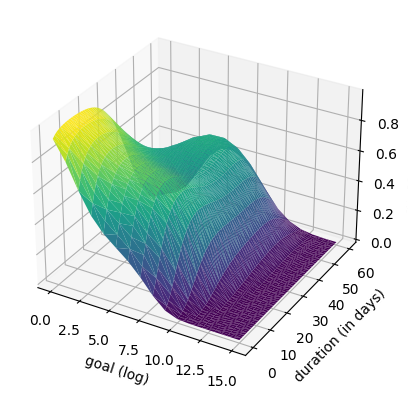

In [654]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.plot_trisurf(df_param["goal_log"], df_param["duration"], df_param["success_chance"], cmap="viridis")
ax.set_xlabel("goal (log)")
ax.set_ylabel("duration (in days)")
ax.set_zlabel("success chance")
plt.show()

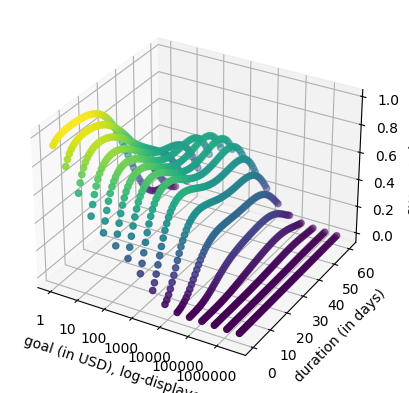

In [641]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(df_param["goal_log"], df_param["duration"], df_param["success_chance"], c = df_param["success_chance"])#, cmap="OrRd")
ax.set_xlabel("goal (in USD), log-displayed")
x_ax_labels = [1, 10, 100, 1000, 10000, 100000, 1000000]
x_ax_label_locations = np.log(x_ax_labels)
plt.xticks(x_ax_label_locations, x_ax_labels)
ax.set_ylabel("duration (in days)")
ax.set_zlabel("success chance")
plt.show()

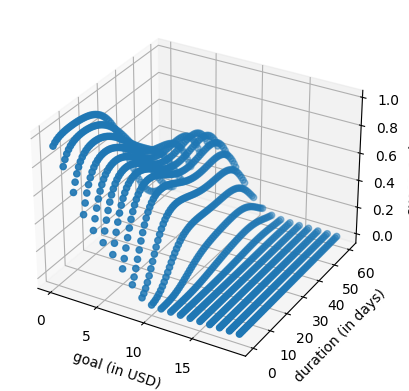

In [599]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(np.log(df_param.goal_no_log), df_param["duration"], df_param["success_chance"])
ax.set_xlabel("goal (in USD)")
ax.set_ylabel("duration (in days)")
ax.set_zlabel("success chance")
plt.show()

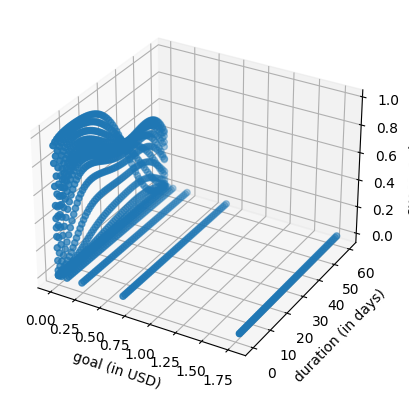

In [597]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(df_param["goal_no_log"], df_param["duration"], df_param["success_chance"])
ax.set_xlabel("goal (in USD)")
ax.set_ylabel("duration (in days)")
ax.set_zlabel("success chance")
plt.show()

### Trees

In [85]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

In [86]:
model = "dt_basic"
#
models[model] = {}
#polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#tree = {}
#
for category in categories:
    #
    models[model][category] = DecisionTreeClassifier(random_state = 42, class_weight="balanced", max_depth = 15, min_samples_split = 5)
    models[model][category].fit(X_train_wo_outlier[category], y_train_wo_outlier[category])
    #
    y_pred_train[model][category] = models[model][category].predict(X_train_wo_outlier[category])
    y_pred_test[model][category] = models[model][category].predict(X_test[category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]


,category,Recall train,Recall test
0,Fashion,0.626476,0.467742
1,Art,0.711914,0.619613
2,Journalism,0.761905,0.404040
3,Film & Video,0.717603,0.645725
4,Publishing,0.724521,0.609016
5,Music,0.702181,0.658201
6,Photography,0.615415,0.402778
7,Technology,0.676729,0.537802
8,Theater,0.785995,0.703502
9,Crafts,0.716273,0.521327


In [87]:
model = "rf_basic"
#
models[model] = {}
#polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#tree = {}
#
for category in categories:
    #
    models[model][category] = RandomForestClassifier(random_state = 42, class_weight = "balanced", n_jobs = -1, n_estimators = 10, max_depth = 10, min_samples_split = 10, min_samples_leaf = 10, max_features = 2)
    models[model][category].fit(X_train_wo_outlier[category], y_train_wo_outlier[category])
    #
    y_pred_train[model][category] = models[model][category].predict(X_train_wo_outlier[category])
    y_pred_test[model][category] = models[model][category].predict(X_test[category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]


,category,Recall train,Recall test
0,Fashion,0.557221,0.509857
1,Art,0.676576,0.653474
2,Journalism,0.606178,0.489899
3,Film & Video,0.705828,0.679620
4,Publishing,0.683353,0.642213
5,Music,0.694946,0.670899
6,Photography,0.582776,0.496914
7,Technology,0.618353,0.561964
8,Theater,0.732297,0.705837
9,Crafts,0.659407,0.571090


In [90]:
model = "rf_optimised_for_art"
#
models[model] = {}
#polynomial_features[model] = {}
scalers[model] = {}
#
x_train_poly[model] = {}
x_test_poly[model] = {}
x_train_scaled[model] = {}
x_test_scaled[model] = {}
x_train_transformed[model] = {}
x_test_transformed[model] = {}
#
y_pred_train[model] = {}
y_pred_test[model] = {}
#
recalls_train[model] = {}
recalls_test[model] = {}
#
#tree = {}
#
for category in categories:
    #
    # hyperparameters from Nupur's grid search
    models[model][category] = RandomForestClassifier(random_state = 42, class_weight = "balanced", n_jobs = -1, bootstrap = True, max_depth = 10, min_samples_leaf = 4, min_samples_split = 2, n_estimators = 100)
    models[model][category].fit(X_train_wo_outlier[category], y_train_wo_outlier[category])
    #
    y_pred_train[model][category] = models[model][category].predict(X_train_wo_outlier[category])
    y_pred_test[model][category] = models[model][category].predict(X_test[category])
    #
    recalls_train[model][category] = recall_score(y_train_wo_outlier[category], y_pred_train[model][category])
    recalls_test[model][category] = recall_score(y_test[category], y_pred_test[model][category])
#
df_recalls[model] = pd.DataFrame({
    "category": categories,
    "Recall train": recalls_train[model].values(),
    "Recall test": recalls_test[model].values()
})
df_recalls[model]


,category,Recall train,Recall test
0,Fashion,0.579473,0.519713
1,Art,0.695872,0.662709
2,Journalism,0.629344,0.464646
3,Film & Video,0.736444,0.709197
4,Publishing,0.690232,0.636066
5,Music,0.720296,0.694180
6,Photography,0.592607,0.487654
7,Technology,0.615154,0.559626
8,Theater,0.759835,0.715953
9,Crafts,0.663037,0.585308


In [92]:
df_recalls["rf_optimised_for_art"]["Recall test"].mean()

0.6260319051119582

In [88]:
def myplot_tree(model, category):
    #model_data = models[model][category]
    # create Kickstarter parameter grid for pairs of goal_log (!) and duration
    list_goal_log = np.arange(0,16,0.5) 
    list_duration = np.arange(0,61) 
    project_parameters = []
    #
    for goal in list_goal_log:
        for duration in list_duration:
            project_parameters.append([goal, duration])
    df_param = pd.DataFrame(project_parameters, columns = ["goal_log", "duration"])
    #
    # apply scaling and polynomials to the Kickstarter parameter valuers
    # 1: scaling
    #df_param_scaled = scalers[model][category].transform(df_param)
    # 2: polynomial
    #df_param_poly = polynomial_features[model][category].transform(df_param_scaled)
    # predict success change
    kick_predict = models[model][category].predict_proba(df_param)[:,1] # this gives us the second column, i.e. class = 1/success
    # add prediction to project parameter grid
    df_param["success_chance"] = kick_predict
    df_param["goal_no_log"] = np.exp(df_param.goal_log)
    #
    # create plot
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    ax.scatter(df_param["goal_log"], df_param["duration"], df_param["success_chance"], c = df_param["success_chance"])#, cmap="OrRd")
    ax.set_xlabel("goal (in USD), log-displayed")
    x_ax_labels = [1, 10, 100, 1000, 10000, 100000, 1000000]
    x_ax_label_locations = np.log(x_ax_labels)
    plt.xticks(x_ax_label_locations, x_ax_labels)
    ax.set_ylabel("duration (in days)")
    ax.set_zlabel("success chance")
    ax.set_title(category)
    plt.show()

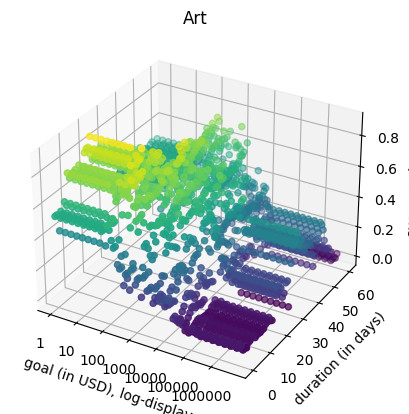

In [93]:
myplot_tree("rf_optimised_for_art", "Art")